<a href="https://colab.research.google.com/github/NJain121442/course2020/blob/master/17August_SEM_UNET_V1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch.nn as nn
import glob
from torch.utils.data import Dataset, DataLoader
import torch
import torch.nn.functional as F
import torch.optim as optim
from IPython.display import clear_output
from torchvision import datasets, transforms
import numpy as np
from torchsummary import summary 
import matplotlib.image as mpimg
import torchvision
from PIL import Image
import matplotlib.pyplot as plt
import cv2
from google.colab.patches import cv2_imshow

In [ ]:
from google.colab import drive 
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#!unzip '/content/drive/My Drive/AutoEncoder_training.zip' -d '/content/drive/My Drive/AutoEncoder_training' 

In [ ]:
#!unzip '/content/drive/My Drive/HKMG-FI_180_class_images.zip' -d '/content/drive/My Drive/'

In [ ]:
#Data_path = "/content/Fruits/"
Data_path = "/content/drive/My Drive/AutoEncoder_training/AutoEncoder_training/"
#Data_path = "/content/drive/My Drive/All_class_images"

In [ ]:
#filelist = glob.glob(Data_path+'/*.jfif')
filelist = glob.glob(Data_path+'/*.tiff')

In [ ]:
len(filelist)

182

Lets Resize all images to same size

In [ ]:
class CustomDataset(Dataset):
  def __init__(self,path,new_size = 226):
    #self.filelist = glob.glob(path+'/*.jfif')
    self.filelist = glob.glob(path+'/*.tiff')
    self.new_size = new_size

  def __len__(self):
    return len(self.filelist)

  def __getitem__(self, idx):
    temp_filepath = self.filelist[idx]
    temp_image = cv2.imread(temp_filepath)
    #print(temp_image)
    #print('Original Dimensions : ',temp_image.shape)
    #cv2_imshow(temp_image)
    temp_image = cv2.cvtColor(temp_image, cv2.COLOR_BGR2GRAY)
    #print('Original Dimensions : ',temp_image.shape)
    #cv2_imshow(temp_image)
    #dim = (504,504)
    #temp_image = cv2.resize(temp_image, dim, interpolation = cv2.INTER_AREA)
    #print('Resized Dimensions : ',temp_image.shape)
    #cv2_imshow(temp_image)
    #print(temp_image.shape)
    temp_image = temp_image/255
    #plt.imshow(temp_image,cmap='gray',vmin=0,vmax=1)
    #temp_image = torch.from_numpy(temp_image)
    temp_image = torch.Tensor(temp_image)
    #print(temp_image.shape)
    #print(temp_image)
    temp_image = temp_image.unsqueeze(0)
    #print(temp_image.shape)
    return temp_image

In [ ]:
Data = CustomDataset(Data_path)
Data[2].shape

torch.Size([1, 504, 504])

In [ ]:
latent_dim = 128

class Encoder(nn.Module):
    def __init__(self):
        super(Encoder,self).__init__()
        self.enc1 = nn.Conv2d(1,64,kernel_size=3,stride=3)
        self.enc2 = nn.Conv2d(64,128,kernel_size=3,stride=3)
        self.enc3 = nn.Conv2d(128,256,kernel_size=2,stride=3)
        self.pool = nn.MaxPool2d(2,2,return_indices=True)
        self.FC1 = nn.Linear(6400,1024)
        self.FC2 = nn.Linear(1024,latent_dim)

    def forward(self,x):
        conv1 = F.relu(self.enc1(x)) # output will be 168x168x64
        x,indices1 = self.pool(conv1) #output will be 84x84x64
        conv2 = F.relu(self.enc2(x)) #output will be 28x28x128
        x,indices2 = self.pool(conv2)   # output will be 14x14x128
        conv3 = F.relu(self.enc3(x)) #output will be 5x5x256 
        x = conv3.view(-1,6400) # after flattening the size will be 6400
        x = F.relu(self.FC1(x))
        x = F.relu(self.FC2(x)) # the latent space representation
        return x,indices1,indices2,conv3,conv2,conv1
    
class Decoder(nn.Module):
    def __init__(self):
        super(Decoder,self).__init__()
        self.FC3 = nn.Linear(latent_dim,1024)
        self.FC4 = nn.Linear(1024,6400)
        self.dec1 = nn.ConvTranspose2d(256 + 256,128, kernel_size=2, stride=3)  
        self.dec2 = nn.ConvTranspose2d(128 + 128,64, kernel_size=3, stride=3)
        self.dec3 = nn.ConvTranspose2d(64 + 64 ,1, kernel_size=3, stride=3)
        self.unpool = nn.MaxUnpool2d(2,2,padding=0)
        
        
    def forward(self,x,indices1,indices2,conv3,conv2,conv1):
        x = F.relu(self.FC3(x)) #size back to 1024
        x = F.relu(self.FC4(x)) #size back to 6400
        x = torch.reshape(x,(1,256,5,5))
        x = torch.cat([x,conv3],dim=1)
        x = F.relu(self.dec1(x)) # ouput will be 14x14x128
        x = self.unpool(x,indices2) #output will be 28x28x128
        x = torch.cat([x,conv2],dim=1)
        x = F.relu(self.dec2(x)) # output will be 84x84x64
        x = self.unpool(x,indices1) #output will be 168x168x64
        x = torch.cat([x,conv1],dim=1)
        #x = self.dec3(x) # output will be 504x504x1
        x = torch.sigmoid(self.dec3(x)) # output will be 504x504x1
        return x
    
class Conv2d_AutoEncoder(nn.Module):
    def __init__(self):
        super(Conv2d_AutoEncoder, self).__init__()

        self.enc = Encoder()
        self.dec = Decoder()

    def forward(self, x):
        
        z,indices1,indices2,conv3,conv2,conv1 = self.enc(x)
        
        out = self.dec(z,indices1,indices2,conv3,conv2,conv1)
        
        return out

**Lets write the first Auto encoder **

In [ ]:
net = Conv2d_AutoEncoder()
print(net)
if torch.cuda.is_available():
    net.cuda()
#summary(net,input_size=(1,504,504))

Conv2d_AutoEncoder(
  (enc): Encoder(
    (enc1): Conv2d(1, 64, kernel_size=(3, 3), stride=(3, 3))
    (enc2): Conv2d(64, 128, kernel_size=(3, 3), stride=(3, 3))
    (enc3): Conv2d(128, 256, kernel_size=(2, 2), stride=(3, 3))
    (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (FC1): Linear(in_features=6400, out_features=1024, bias=True)
    (FC2): Linear(in_features=1024, out_features=128, bias=True)
  )
  (dec): Decoder(
    (FC3): Linear(in_features=128, out_features=1024, bias=True)
    (FC4): Linear(in_features=1024, out_features=6400, bias=True)
    (dec1): ConvTranspose2d(512, 128, kernel_size=(2, 2), stride=(3, 3))
    (dec2): ConvTranspose2d(256, 64, kernel_size=(3, 3), stride=(3, 3))
    (dec3): ConvTranspose2d(128, 1, kernel_size=(3, 3), stride=(3, 3))
    (unpool): MaxUnpool2d(kernel_size=(2, 2), stride=(2, 2), padding=(0, 0))
  )
)


In [ ]:
train_loader = DataLoader(Data,batch_size=1)

In [ ]:
loss_func = nn.MSELoss()
#loss_func = nn.L1Loss()
optimizer = optim.Adam(net.parameters(), lr=0.0001) 


Training the Auto encoder

In [ ]:
!pip install kornia
from kornia import filters

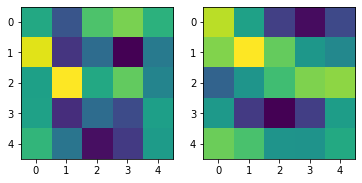

In [ ]:
input = torch.rand(2, 4, 5, 5)
fig,ax = plt.subplots(1,2)
ax[0].imshow(input[0][0])
SpatialGradient = filters.SpatialGradient()
output = SpatialGradient(input)
ax[1].imshow(output[0][0][1])

In [ ]:
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt

n_epochs = 100

if torch.cuda.is_available():
    net.cuda()
total_loss = []

epoch_loss = 0
net.train()
for epoch in tqdm(range(n_epochs)):
    print("current epoch is:",epoch)
    epoch_loss = 0
    for x in train_loader:
        mse_loss = 0
        if torch.cuda.is_available():
          x = x.cuda()
        optimizer.zero_grad()
        prediction = net(x)
        loss_der = loss_func(SpatialGradient(prediction), SpatialGradient(x))
        mse_loss = loss_func(prediction, x) # <-- note that i'm using the input as the target
        (mse_loss+loss_der).backward()
        optimizer.step()
        epoch_loss = epoch_loss + mse_loss.item() + loss_der.item()

        
    #clear_output(wait=True)
    total_loss.append(epoch_loss)
    print('Loss Per epoch: ',epoch_loss)

current epoch is: 0
Loss Per epoch:  9.235715394373983
current epoch is: 1
Loss Per epoch:  6.298046966490801
current epoch is: 2
Loss Per epoch:  4.217379208654165
current epoch is: 3
Loss Per epoch:  3.1969661666662432
current epoch is: 4
Loss Per epoch:  2.5716717257746495
current epoch is: 5
Loss Per epoch:  2.174030889349524
current epoch is: 6
Loss Per epoch:  1.8682800777023658
current epoch is: 7
Loss Per epoch:  1.6134162687230855
current epoch is: 8
Loss Per epoch:  1.3832092087250203
current epoch is: 9
Loss Per epoch:  1.1777850705257151
current epoch is: 10
Loss Per epoch:  1.0102073702728376
current epoch is: 11
Loss Per epoch:  0.838513361493824
current epoch is: 12
Loss Per epoch:  0.6906947784300428
current epoch is: 13
Loss Per epoch:  0.5767328260990325
current epoch is: 14
Loss Per epoch:  0.4829218213126296
current epoch is: 15
Loss Per epoch:  0.40654222574084997
current epoch is: 16
Loss Per epoch:  0.3436952207266586
current epoch is: 17
Loss Per epoch:  0.29266

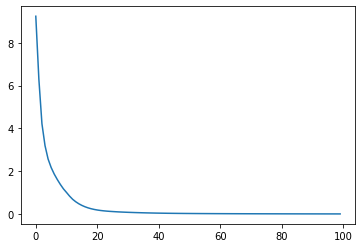

In [ ]:
import matplotlib.pyplot as plt
plt.plot(total_loss)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


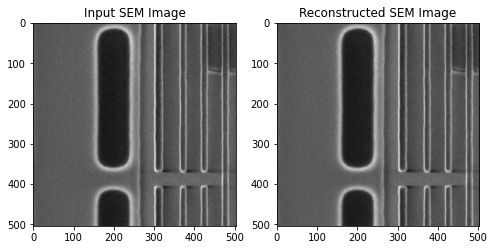

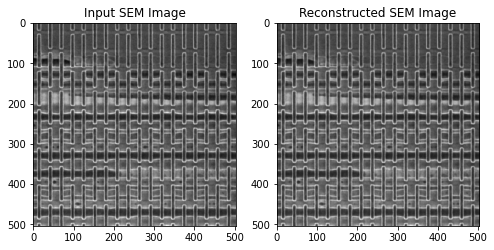

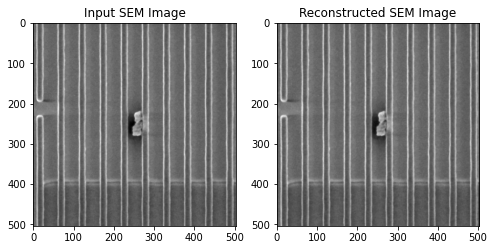

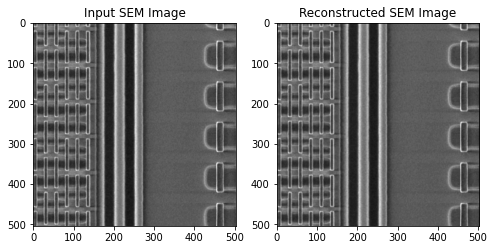

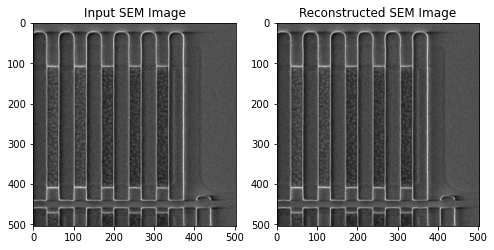

...

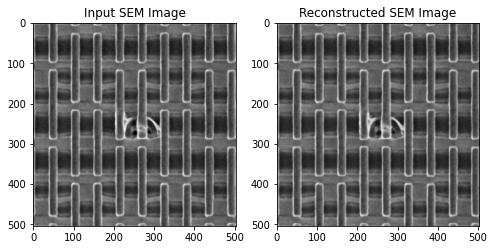

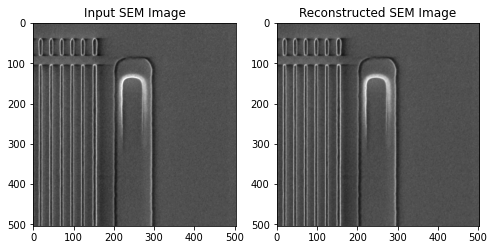

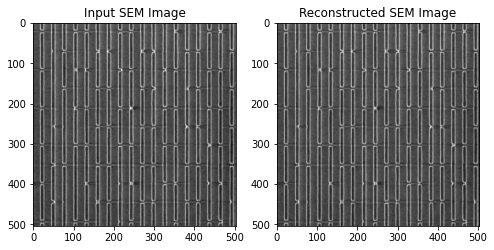

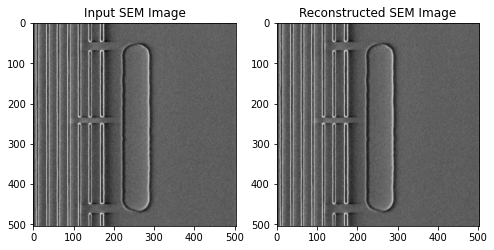

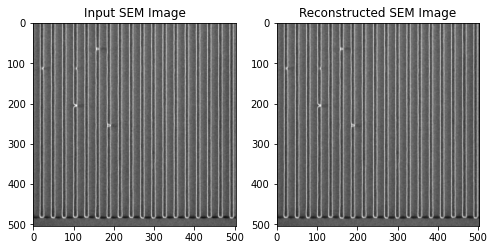

In [ ]:
net.cpu()
net.eval()
counter = 0
for i in range(30):
    counter = counter + 1
    fig,ax = plt.subplots(1,2,figsize=(8,4))
    x = Data[i]
    input_img = x[0]
    #print(input_img)
    model_pred = net(x.unsqueeze(0))[0].cpu().data.numpy()[0]
    #print(model_pred)
    ax[0].set_title('Input SEM Image',fontsize=12)
    ax[1].set_title('Reconstructed SEM Image',fontsize=12)
    ax[0].imshow(input_img,cmap='gray',vmin=0,vmax=1)
    ax[1].imshow(model_pred,cmap='gray',vmin=0,vmax=1)


Extract Latent representation from Encoder 

Do Clustering and calculate Silhouette Score

In [ ]:
from sklearn.cluster import KMeans
from sklearn import preprocessing
from sklearn.metrics import silhouette_samples, silhouette_score
Encoder_net = Encoder()
Attributes = np.empty([len(train_loader),latent_dim])
#print(Attributes.shape)
for i,x in enumerate(Data):
  Temp_results = Encoder_net(x.unsqueeze(0))
  #print(Temp_results[0])
  Temp_Attributes = (Temp_results[0]).cpu().data.numpy()
  #print("Temp_Attributes:",Temp_Attributes)
  Attributes[i] = Temp_Attributes
  #print(Attributes[i].shape)
#print(Attributes.shape)

In [ ]:
k=15
Attributes = preprocessing.scale(Attributes)
print(Attributes.mean(axis=0))
print(Attributes.std(axis=0))
kmeans = KMeans(n_clusters=k,random_state=0).fit(Attributes)
Clustering_labels = kmeans.labels_
print(Clustering_labels)
Score = silhouette_score(Attributes,Clustering_labels,metric='euclidean')
print(Score)
sample_score = silhouette_samples(Attributes,Clustering_labels,metric='euclidean')
#print(sample_score)

[13  9  3  7  7  8 13  8 10 13 13 11  7  9 11  7 10 13  7  4  8 13  9  2
  8 12 11  0  7  0  9  9 10 12  0 12 12  9  9 11  4  9  6  4  2  9 12  0
  2  1  2  6  6 11  5 13  1  1  5  5  5  5  5  1  5  5 13  9  7  7  7 13
  4 11  7 11  8 10  1 13 14 14 10 10  9  7  7  7 10  1 10  9 10 10 13  7
  9 13  8  8  6  1 10  5  9  0  0  0  4 12  3  9 14 12 13  4  4 11 11  4
  0 11 11 11  4  2  0  2  2 11  0 12 11  9  9 11 13 11 13  2  4 14 10  1
  7  3  1  1  6  6  1  6  6 10  6  6 10 14 14  7  1 10  2 11 11 13 10  3
  7 10  8  8 10 14  8  9  9  1 10  9 11  4]
0.08718556804547056


In [ ]:
max(sample_score)

0.4606904290030105

Find Optimal K using Silhouette score

In [ ]:
k_range = 20
Score = np.empty(20)
for k in range(k_range):
  kmeans = KMeans(n_clusters=k+2,random_state=0).fit(Attributes)
  Clustering_labels_k = kmeans.labels_
  Score[k] = silhouette_score(Attributes,Clustering_labels_k)
print(Score)
Max_score_k = np.argmax(Score) + 2
print(Max_score_k)


[0.13358484 0.08840292 0.09409222 0.09455363 0.09438467 0.09342911
 0.09551187 0.09010778 0.08934659 0.0909817  0.08493999 0.09105311
 0.07729344 0.08718557 0.07908277 0.0837308  0.0859059  0.08527887
 0.08108325 0.09915448]
2


In [ ]:
import pandas as pd 
column_names = ["Image","Label","sample_score"]
df = pd.DataFrame(columns = column_names,index=np.arange(len(Data)))
df['Image'][88]

for i,x in enumerate(Data):
  df['Image'][i] = (x[0]).data.numpy()
  df['Label'][i] = Clustering_labels[i]
  df['sample_score'][i] = sample_score[i]
  #print(input_img)

In [ ]:
df

,Image,Label
0,"[[0.3254902, 0.32941177, 0.32941177, 0.3254902...",13
1,"[[0.27450982, 0.27450982, 0.27450982, 0.282352...",9
2,"[[0.40784314, 0.40784314, 0.40392157, 0.4, 0.3...",3
3,"[[0.6784314, 0.6431373, 0.5176471, 0.29803923,...",7
4,"[[0.34117648, 0.34117648, 0.34117648, 0.345098...",7
...,...,...
177,"[[0.34901962, 0.34901962, 0.3529412, 0.3607843...",1
178,"[[0.30588236, 0.30588236, 0.30588236, 0.305882...",10
179,"[[0.34117648, 0.34117648, 0.34117648, 0.352941...",9
180,"[[0.3019608, 0.28235295, 0.2627451, 0.24313726...",11


In [ ]:
df= df.sort_values('Label',ignore_index=True)
print(df)
df['Image'][120]

                                                 Image Label
0    [[0.3647059, 0.35686275, 0.3529412, 0.34901962...     0
1    [[0.84313726, 0.84313726, 0.7490196, 0.3568627...     0
2    [[0.3529412, 0.35686275, 0.3647059, 0.36862746...     0
3    [[0.34901962, 0.34901962, 0.36078432, 0.364705...     0
4    [[0.34509805, 0.3372549, 0.33333334, 0.3725490...     0
..                                                 ...   ...
177  [[0.36078432, 0.36078432, 0.36078432, 0.360784...    14
178  [[0.4, 0.4, 0.39607844, 0.3882353, 0.38039216,...    14
179  [[0.4117647, 0.4117647, 0.40784314, 0.40784314...    14
180  [[0.36862746, 0.36862746, 0.37254903, 0.372549...    14
181  [[0.3254902, 0.3254902, 0.32941177, 0.34117648...    14

[182 rows x 2 columns]


array([[0.36078432, 0.36078432, 0.3647059 , ..., 0.4745098 , 0.47843137,
        0.47843137],
       [0.36078432, 0.36078432, 0.3647059 , ..., 0.47843137, 0.47843137,
        0.47843137],
       [0.35686275, 0.35686275, 0.3647059 , ..., 0.47843137, 0.47843137,
        0.47843137],
       ...,
       [0.34901962, 0.3529412 , 0.3529412 , ..., 0.42352942, 0.43137255,
        0.43529412],
       [0.34117648, 0.34509805, 0.34901962, ..., 0.42745098, 0.43137255,
        0.43529412],
       [0.3372549 , 0.34117648, 0.34509805, ..., 0.43137255, 0.43137255,
        0.43529412]], dtype=float32)

182


<function matplotlib.pyplot.show>

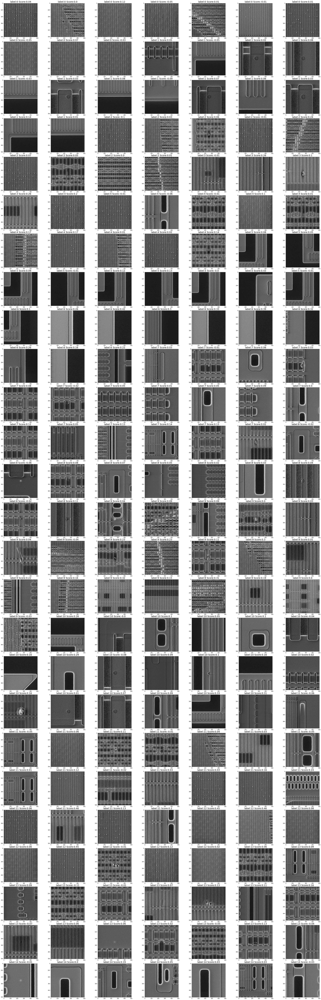

In [ ]:
ncols = 9
print(len(Data))
nrows = int(len(Data)/ncols)
figsize = [40,50]  
fig,ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
axi = ax.flat
#print(len(axi))
for i,x in enumerate(Data):
  input_img = df['Image'][i]
  axi[i].set_title("label:"+str(df['Label'][i])+" "+"Score:"+str(round(df['sample_score'][i],2)),fontsize =20)
  #plt.title('Input SEM Image',fontsize=6)
  axi[i].imshow(input_img,cmap='gray',vmin=0,vmax=1)
fig.tight_layout(pad=0.3)
plt.show